In [2]:

import torch
from torchvision import models
import numpy as np

C:\Users\soso6\miniconda3\envs\Deeplearning with PyTorch\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: 
  warn(f"Failed to load image Python extension: {e}")


In [3]:

torch.cuda.is_available()


True

In [4]:

dir(models)


['AlexNet',
 'AlexNet_Weights',
 'ConvNeXt',
 'ConvNeXt_Base_Weights',
 'ConvNeXt_Large_Weights',
 'ConvNeXt_Small_Weights',
 'ConvNeXt_Tiny_Weights',
 'DenseNet',
 'DenseNet121_Weights',
 'DenseNet161_Weights',
 'DenseNet169_Weights',
 'DenseNet201_Weights',
 'EfficientNet',
 'EfficientNet_B0_Weights',
 'EfficientNet_B1_Weights',
 'EfficientNet_B2_Weights',
 'EfficientNet_B3_Weights',
 'EfficientNet_B4_Weights',
 'EfficientNet_B5_Weights',
 'EfficientNet_B6_Weights',
 'EfficientNet_B7_Weights',
 'EfficientNet_V2_L_Weights',
 'EfficientNet_V2_M_Weights',
 'EfficientNet_V2_S_Weights',
 'GoogLeNet',
 'GoogLeNetOutputs',
 'GoogLeNet_Weights',
 'Inception3',
 'InceptionOutputs',
 'Inception_V3_Weights',
 'MNASNet',
 'MNASNet0_5_Weights',
 'MNASNet0_75_Weights',
 'MNASNet1_0_Weights',
 'MNASNet1_3_Weights',
 'MobileNetV2',
 'MobileNetV3',
 'MobileNet_V2_Weights',
 'MobileNet_V3_Large_Weights',
 'MobileNet_V3_Small_Weights',
 'RegNet',
 'RegNet_X_16GF_Weights',
 'RegNet_X_1_6GF_Weights',
 'R


# AlexNet
---
- 여러 개의 곱셉과 덧셈으로 이루어져 있다.
- 출력에 다른 함수를 섞는 요소가 있다.

![image](https://user-images.githubusercontent.com/76675506/188373698-29c5351d-6418-44a5-b638-1edbab6b995f.png)

↑ 입력(Input) 이미지가 각 층을 거치며 변환된 이미지가 출력된다. 층을 거칠때마다 아래에 적힌 숫자 크기로 줄어들게 된다.


In [5]:

alexnet = models.AlexNet() #AlexNet 인스턴스 생성
# 초기 인스턴스는 가중치가 초기화된 상태다.
# 새로 훈련을 시키거나, 기존에 훈련된 가중치를 불러올 수 있다.


In [6]:
alexnet = models.alexnet(pretrained=True)

C:\Users\soso6\miniconda3\envs\Deeplearning with PyTorch\lib\site-packages\torchvision\models\_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
C:\Users\soso6\miniconda3\envs\Deeplearning with PyTorch\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


# ResNet
---
계층 수가 101개인 컨볼루션 신경망 (101-layer Convolutional Neural Network)
- 잔차 신경망(residual network)를 약간의 트릭으로 가능하게 만든 모델

In [7]:

resnet = models.resnet101(pretrained=True) # 이미지넷으로 훈련이 완료된 모델 불러오기

C:\Users\soso6\miniconda3\envs\Deeplearning with PyTorch\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [8]:

resnet # ResNet의 아키텍처 확인

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [9]:

from torchvision import transforms
preprocess = transforms.Compose([
    transforms.Resize(256), # 이미지 크기 조정 (256x256)
    transforms.CenterCrop(224), # 중심으로 부터 224x224만큼 crop
    transforms.ToTensor(), # 텐서 형태로 전환
    transforms.Normalize( # RGB 값을 지정된 값(평균, 표준편차)을 가지도록 정규화
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

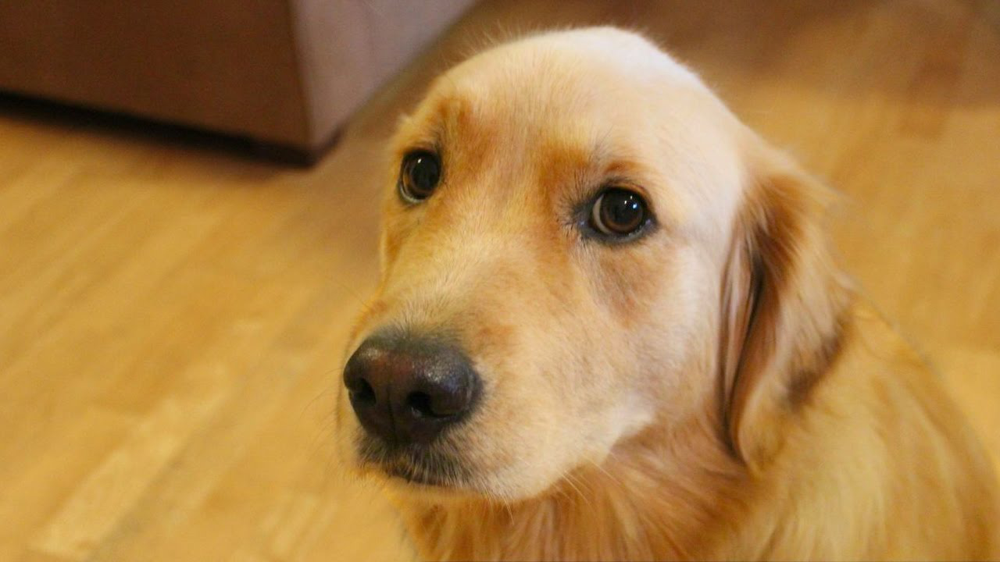

In [10]:
from PIL import Image
img = Image.open('C:\\Users\\soso6\\Documents\\Python\Deeplearning with PyTorch\\img\dog.png')

img

In [11]:

img_t = preprocess(img)

print(np.shape(img_t),'\n', img_t)

torch.Size([3, 224, 224]) 
 tensor([[[-0.6281, -0.6623, -0.6794,  ...,  0.0056, -0.0287, -0.0629],
         [-0.7137, -0.7137, -0.7137,  ...,  0.0398,  0.0227,  0.0056],
         [-0.7137, -0.7137, -0.7137,  ...,  0.0398,  0.0569,  0.0569],
         ...,
         [ 1.4440,  1.4269,  1.4783,  ...,  0.6049,  0.6221,  0.6906],
         [ 1.4269,  1.4440,  1.4783,  ...,  0.6906,  0.6734,  0.7077],
         [ 1.4612,  1.4783,  1.5125,  ...,  0.6906,  0.7248,  0.7419]],

        [[-1.2829, -1.2829, -1.2829,  ..., -0.6352, -0.6702, -0.7052],
         [-1.2654, -1.2479, -1.2654,  ..., -0.6176, -0.6527, -0.7052],
         [-1.2479, -1.2479, -1.2654,  ..., -0.6176, -0.6001, -0.6527],
         ...,
         [ 0.7829,  0.8004,  0.8704,  ..., -0.3025, -0.2675, -0.2150],
         [ 0.7654,  0.8354,  0.9055,  ..., -0.2150, -0.2150, -0.1625],
         [ 0.8004,  0.8529,  0.9230,  ..., -0.1800, -0.1275, -0.0749]],

        [[-1.4907, -1.4559, -1.4210,  ..., -1.0376, -1.0898, -1.1421],
         [-1.5081

In [12]:
batch_t = torch.unsqueeze(img_t,0)

print(np.shape(batch_t), '\n', batch_t)

torch.Size([1, 3, 224, 224]) 
 tensor([[[[-0.6281, -0.6623, -0.6794,  ...,  0.0056, -0.0287, -0.0629],
          [-0.7137, -0.7137, -0.7137,  ...,  0.0398,  0.0227,  0.0056],
          [-0.7137, -0.7137, -0.7137,  ...,  0.0398,  0.0569,  0.0569],
          ...,
          [ 1.4440,  1.4269,  1.4783,  ...,  0.6049,  0.6221,  0.6906],
          [ 1.4269,  1.4440,  1.4783,  ...,  0.6906,  0.6734,  0.7077],
          [ 1.4612,  1.4783,  1.5125,  ...,  0.6906,  0.7248,  0.7419]],

         [[-1.2829, -1.2829, -1.2829,  ..., -0.6352, -0.6702, -0.7052],
          [-1.2654, -1.2479, -1.2654,  ..., -0.6176, -0.6527, -0.7052],
          [-1.2479, -1.2479, -1.2654,  ..., -0.6176, -0.6001, -0.6527],
          ...,
          [ 0.7829,  0.8004,  0.8704,  ..., -0.3025, -0.2675, -0.2150],
          [ 0.7654,  0.8354,  0.9055,  ..., -0.2150, -0.2150, -0.1625],
          [ 0.8004,  0.8529,  0.9230,  ..., -0.1800, -0.1275, -0.0749]],

         [[-1.4907, -1.4559, -1.4210,  ..., -1.0376, -1.0898, -1.1421],

In [13]:
resnet.eval() # 사전 학습된 신경망은 eval 모드로 설정해야 올바르게 작동한다.

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [14]:
out = resnet(batch_t)
out # 1000개의 클래스에 대해 스코어를 계산한 결과

tensor([[-3.4803e+00, -1.6618e+00, -2.4515e+00, -3.2662e+00, -3.2466e+00,
         -1.3611e+00, -2.0465e+00, -2.5112e+00, -1.3043e+00, -2.8900e+00,
         -1.6862e+00, -1.3055e+00, -2.6129e+00, -2.9645e+00, -2.4300e+00,
         -2.8143e+00, -3.3019e+00, -7.9404e-01, -6.5182e-01, -1.2308e+00,
         -3.0193e+00, -3.9457e+00, -2.2675e+00, -1.0811e+00, -1.0232e+00,
         -1.0442e+00, -3.0918e+00, -2.4613e+00, -2.1964e+00, -3.2354e+00,
         -3.3013e+00, -1.8553e+00, -2.0921e+00, -2.1327e+00, -1.9102e+00,
         -3.2403e+00, -1.1396e+00, -1.0925e+00, -1.2186e+00, -9.3332e-01,
         -4.5093e-01, -1.5489e+00,  1.4161e+00,  1.0871e-01, -1.8442e+00,
         -1.4806e+00,  9.6227e-01, -9.9456e-01, -3.0060e+00, -2.7384e+00,
         -2.5798e+00, -2.0666e+00, -1.8022e+00, -1.9328e+00, -1.7726e+00,
         -1.3041e+00, -4.5848e-01, -2.0537e+00, -3.2804e+00, -5.0451e-01,
         -3.8174e-01, -1.1147e+00, -7.3998e-01, -1.4299e+00, -1.4883e+00,
         -2.1073e+00, -1.7373e+00, -4.

In [15]:
with open('C:\\Users\soso6\Documents\Python\Deeplearning with PyTorch\data\p1ch2\imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

In [16]:
# 가장 퍼센테이지가 높은 값, 인덱스 출력
_, index = torch.max(out, 1) # 인덱스가 int가 아닌 1d tensor 형태로 나온다.

In [20]:
percentage = torch.nn.functional.softmax(out, dim=1)[0] * 100
labels[index[0]], percentage[index[0]].item() # 인덱스와 레이블 매치

('golden retriever', 96.29334259033203)

In [21]:
# 퍼센테이지 상위 5개 출력
_, indices = torch.sort(out, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('golden retriever', 96.29334259033203),
 ('Labrador retriever', 2.80812668800354),
 ('cocker spaniel, English cocker spaniel, cocker', 0.28267428278923035),
 ('redbone', 0.20863059163093567),
 ('tennis ball', 0.11621591448783875)]

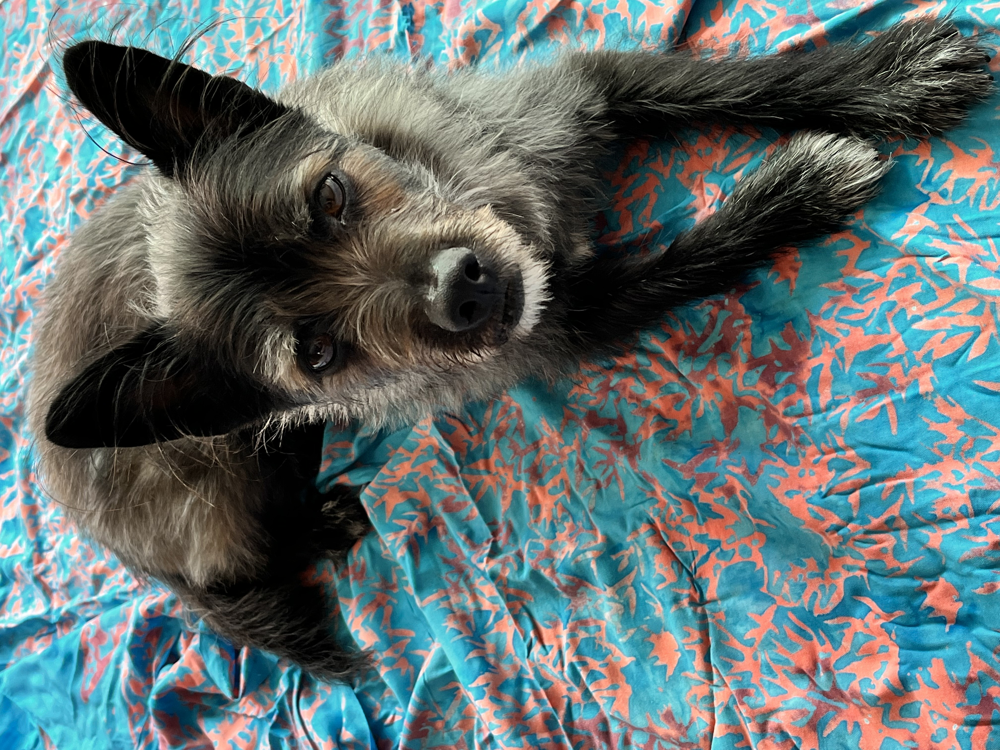

In [29]:
# 에떼 확인
#
img_1 = Image.open('img/KakaoTalk_20220903_141736658.jpg')
img_2 = Image.open('img/KakaoTalk_Moim_3QnznoRaBkl67NuAy4MugT3KqHyxKZ.jpg')

img_1

In [25]:
img_t_1 = preprocess(img_1)
img_t_2 = preprocess(img_2)
batch_t_1 = torch.unsqueeze(img_t_1,0)
batch_t_2 = torch.unsqueeze(img_t_2,0)

In [26]:
out_1 = resnet(batch_t_1)
out_2 = resnet(batch_t_2)

In [27]:
_, indices = torch.sort(out_1, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('affenpinscher, monkey pinscher, monkey dog', 8.512070053257048e-06),
 ('black-footed ferret, ferret, Mustela nigripes', 1.6799243894638494e-05),
 ('miniature schnauzer', 0.0001129188240156509),
 ('Yorkshire terrier', 7.665306475246325e-05),
 ('three-toed sloth, ai, Bradypus tridactylus', 1.237617425431381e-06)]

In [28]:
_, indices = torch.sort(out_2, descending=True)
[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('groenendael', 0.00011930803884752095),
 ('Scotch terrier, Scottish terrier, Scottie', 0.00010096555342897773),
 ('schipperke', 0.0004912085714749992),
 ('flat-coated retriever', 0.03330802544951439),
 ('affenpinscher, monkey pinscher, monkey dog', 8.512070053257048e-06)]


# GAN(Generative Adversarial Network) 게임
---
- GAN은 두 개의 신경망이 결과를 만들고(generative) 서로 경쟁하는(adversarial) 신경망(network)이다.

